# 图像处理

本文主要介绍 Python 图像处理的常用库和函数。

本文目录：

1. PIL
    - 颜色转换
    - 转换图像格式
    - 创建缩略图
    - 裁剪
    - 调整尺寸
    - 旋转
    - 粘贴
2. Matplotlib
    - 绘制图像、点和线
    - 图像中的像素点
    - 图像轮廓
    - 直方图
3. Numpy
    - 像素数组
    - 灰度变换
    - 直方图均衡化
    - 图像平均
    - 图像的主成分分析
    - 使用pickle模块
4. SciPy
    - 图像模糊
    - 图像导数
    - 形态学:对象计数
    - 图像去噪
5. GIF图像处理
    - 将 GIF 图像拆分为图片
    - 制作逆序gif图像

## 1. PIL

PIL（Python Imaging Library，图像处理类库）提供了通用的图像处理功能，以及大量有用的基本图像操作，比如图像缩放、裁剪、旋转、颜色转换等。

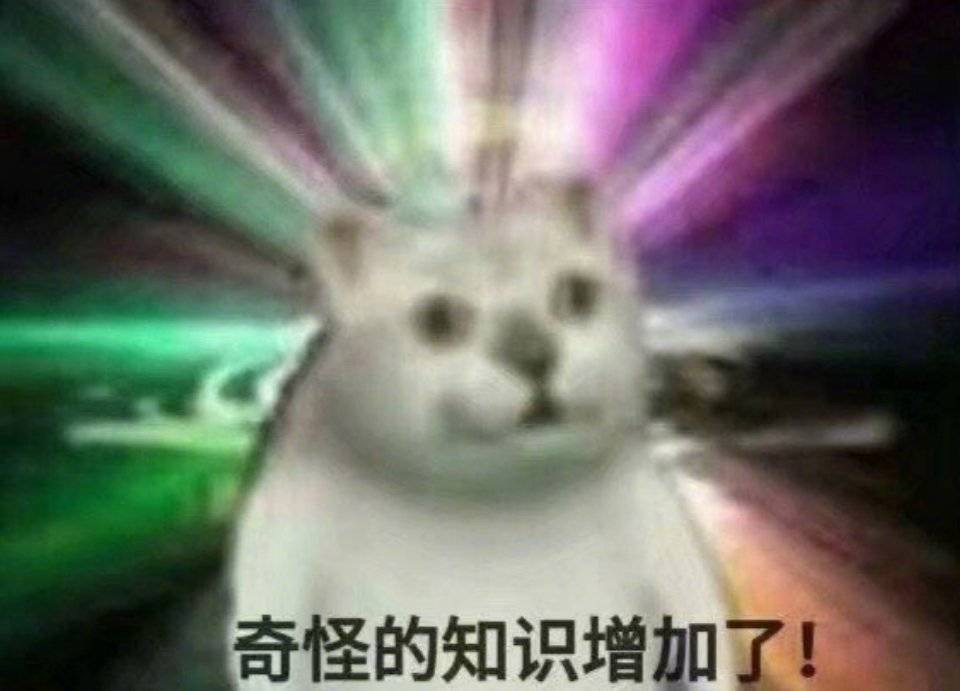

In [1]:
from PIL import Image

pil_im = Image.open('./img/cat.jpg')
pil_im

上述代码的返回值 pil_im 是一个 PIL 图像对象。

### 1.1 颜色转换

图像的颜色转换可以使用 convert() 方法来实现。比如，要将一副图转换成灰度图像，只需要加上 convert('L')，如下所示：

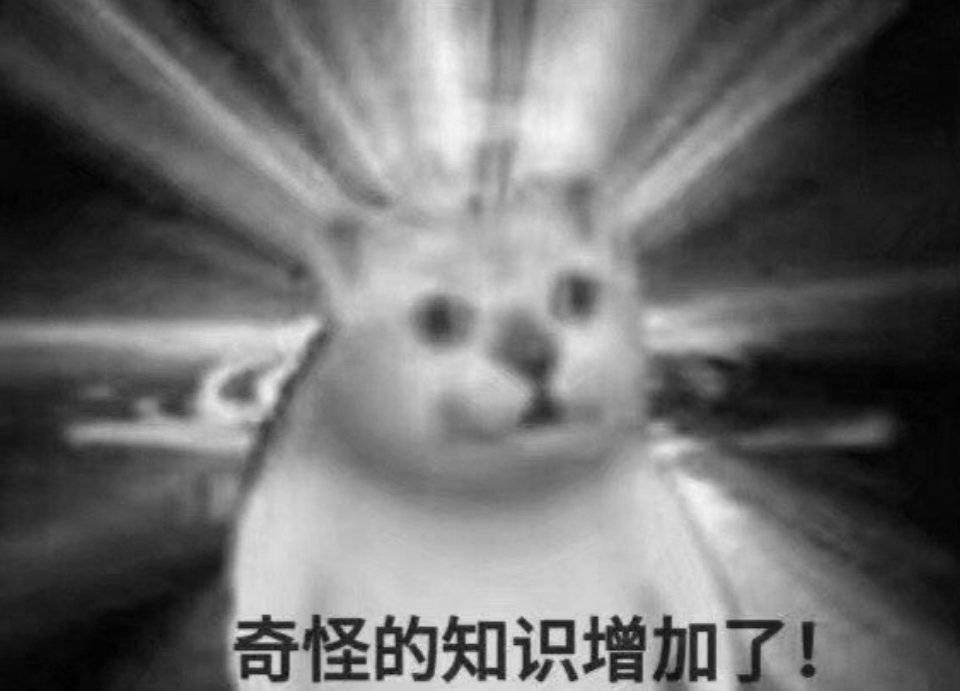

In [2]:
pil_im.convert('L')

### 1.2 转换图像格式

通过 save() 方法，PIL 可以将图像保存成多种格式的文件。

In [3]:
try:
    pil_im.save('./img/cat.png')
except IOError:
    print('Can not convert.')

打开 img 文件夹查看是否生成名为 increasing.png 的图像文件。

### 1.3 创建缩略图

thumbnail() 方法可用于创建缩略图。它接受一个元组参数，来指定生成缩略图的大小。例如，创建最长边为 128 像素的缩略图，可使用以下命令。

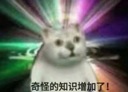

In [4]:
pil_im_copy = pil_im.copy()
pil_im_copy.thumbnail((128, 128))
pil_im_copy

### 1.4 裁剪

使用 crop() 方法可以从一幅图像中裁剪指定区域。

```
box = (100, 100, 400, 400)
region = pil_im.crop(box)
```

该区域使用四元组来指定。四元组的坐标依次是下图中的（①，②，③，④）。

<img src='./img/sample.jpg' width='300px' style='float:left;'><img>


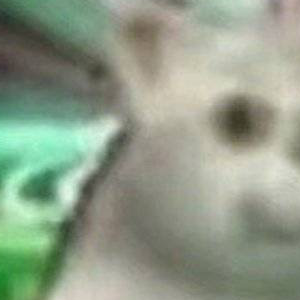

In [5]:
box = (200, 200, 500, 500)
region = pil_im.crop(box)
region

### 1.5 调整尺寸

resize() 方法可以调整图像的尺寸。该方法的参数是一个元组，用来指定新图像的大小。

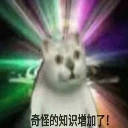

In [6]:
pil_im.resize((128,128))

鉴于调整尺寸的操作非常常用，我们把它写出函数。如下，n 为 5 时代表缩小 5 倍。

In [7]:
def imresize(im, n):
    size = (np.uint(im.shape[1]/n),np.uint(im.shape[0]/n))
    pil_im = Image.fromarray(im)
    return pil_im.resize(size)

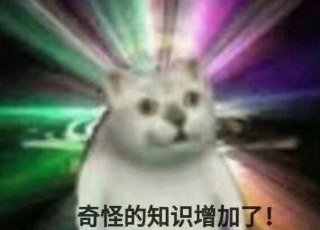

In [8]:
import numpy as np

im = np.array(pil_im)
imresize(im, 3)

### 1.6 旋转

rotate() 方法可以旋转图像。它接受逆时针旋转的角度作为参数。

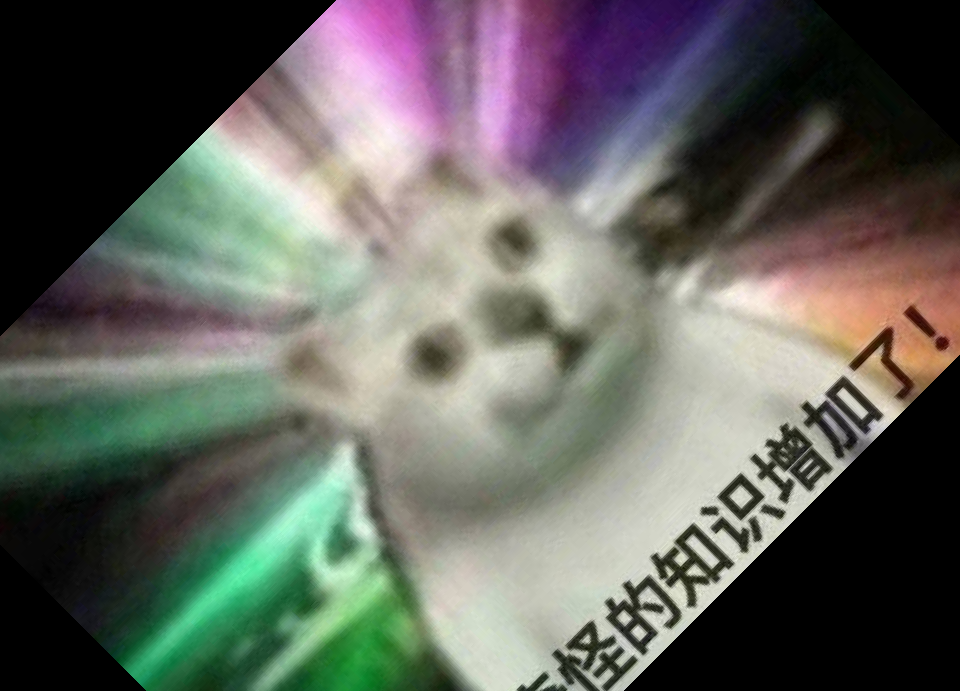

In [9]:
pil_im.rotate(45)

### 1.7 粘贴

下面这些代码将裁剪下来的图片旋转 180 度以后，再贴回原位。

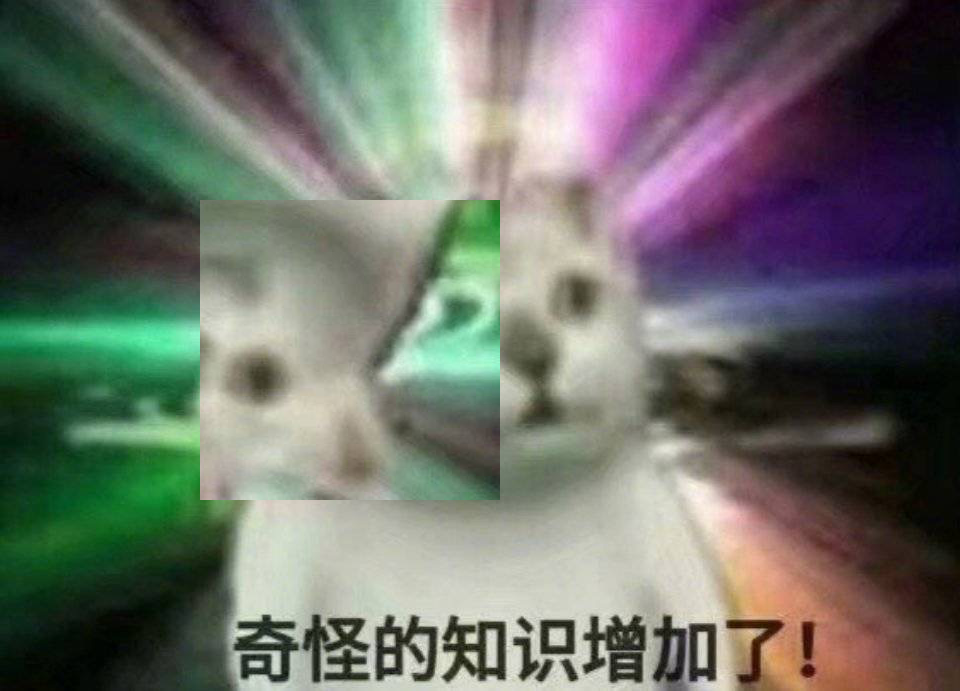

In [10]:
pil_im_copy = pil_im.copy()
region = region.transpose(Image.ROTATE_180) 
pil_im_copy.paste(region,box)
pil_im_copy

## 2. Matplotlib

我们处理数学运算、绘制图表，或者在图像上绘制点、直线和曲线时，Matplotlib 是个很好的类库，具有比 PIL 更强大的绘图功能。

### 2.1 绘制图像、点和线

我们可以用 Matplotlib 在底图上用点和线表示一些事物，比如兴趣点、对应点以及检测出的物体。下面是用几个点和一条线绘制图像的例子。

In [11]:
import matplotlib.pylab as plt

# 读取图像到数组中
im = np.array(Image.open('./img/cat.jpg'))

# 绘制图像
plt.imshow(im)

# 一些点
x = [100, 100, 400, 400]
y = [200, 500, 200, 500]

# 使用红色星状标记绘制点
plt.plot(x,y,'r*')

# 绘制链接前两个点的线
plt.plot(x[:2], y[:2])

# 添加标题，显示绘制的图像
plt.title('Plotting')
plt.show()

<Figure size 640x480 with 1 Axes>

如果你不希望显示坐标轴，可以使用以下命令使之不显示：

```python
plt.axis('off')
```

### 2.2 图像中的像素点

#### 2.2.1 像素点数组的形状

将 im 转换成 ndarray 之后，可以用 shape 方法查看数组的形状。

In [12]:
np.array(im).shape

(691, 960, 3)

结合图像，我们发现：该图像高 691 个像素，宽 960 个像素，每个像素用 3 个数值存储。

#### 2.2.2 像素点的颜色

如果我们希望查看位于 (100, 200) 的像素的取值。可以用以下命令：

In [13]:
np.array(im)[200][100]

array([20, 22, 19], dtype=uint8)

它表示位于 (100, 200) 的像素颜色是 rgb(20, 22, 19)。
<br><br>
<div style="height:30px;width:30px;float:left;background-color: rgb(20, 22, 19);"></div>

如果我们希望查看位于 (400, 600) 的像素的取值。可以用以下命令：

In [14]:
np.array(im)[600][400]

array([211, 213, 199], dtype=uint8)

它表示位于 (400, 600) 的像素颜色是 rgb(211, 213, 199)。
<br><br>
<div style="height:30px;width:30px;float:left;background-color: rgb(211, 213, 199);"></div>

### 2.3 图像轮廓

因为绘制轮廓需要对每个坐标 [x, y] 的像素施加同一个阈值，所以首先需要将图像灰度化。

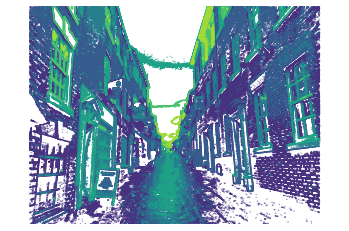

In [15]:
# 读取图像到数组中
im = plt.array(Image.open('./img/view.jpg').convert('L'))

# 画等高线图
plt.contour(im, origin='image')
plt.axis('equal')
_ = plt.axis('off')

### 2.4 直方图

图像的直方图用来表征该图像像素值的分布情况。用一定数目的小区间(bin)来
指定表征像素值的范围，每个小区间会得到落入该小区间表示范围的像素数目。该 (灰度)图像的直方图可以使用 hist() 函数绘制:

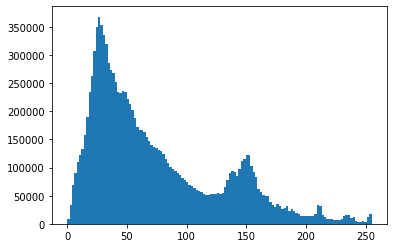

In [16]:
plt.hist(im.flatten(), bins=128)
plt.show()

因为 hist() 只接受一维数组作为输入，所以我们在绘制直方图之前，必须先对图像进行压平处理。flatten() 方法将任意数组按照行优先准则转换成一维数组。

从下述例子可以看出 flatten() 方法具体干了什么。

In [17]:
np.array([[1,2],[3,4]]).flatten()

array([1, 2, 3, 4])

经过 flatten() 压平之后的数组，其数值个数保持不变。

In [18]:
im.shape[0]*im.shape[1] == len(im.flatten())

True

## 3. Numpy

NumPy 中的数组对象是多维的，可以用来表示向量、矩阵和图像。一个数组对象很像一个列表(或者是列表的列表)，但是数组中所有的元素必须具有相同的数据类型。除非创建数组对象时指定数据类型，否则数据类型会按照数据的类型自动确定。

### 3.1 像素数组

对于图像数据，下面例子阐述了这一点。

In [19]:
im = np.array(Image.open('./img/view.jpg'))
print(im.shape, im.dtype)

im = plt.array(Image.open('./img/view.jpg').convert('L'), 'f')
print(im.shape, im.dtype)

(3024, 4032, 3) uint8
(3024, 4032) float32


数组中的元素可以使用下标访问。位于坐标 i, j，以及颜色通道 k 的像素值可以像下面这样访问：

```python
im[i, j, k]
```

In [20]:
im = np.array(Image.open('./img/view.jpg'))
im[200, 300, 2]

44

### 3.2 灰度变换

将图像读入 Numpy 数组后，我们可以对他们执行任意数学操作。一个简单的例子就是图像的灰度变换。考虑任意函数 f，它是映射到它自身的一个函数（即定义域和值域的范围相同）。下面是关于灰度变换的一些例子：

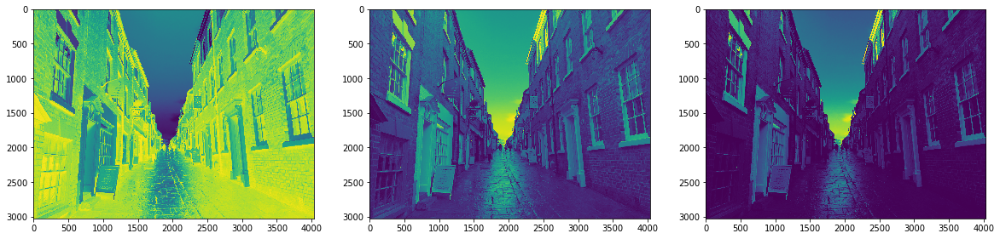

In [21]:
im = np.array(Image.open('./img/view.jpg').convert('L'))

fig, ax = plt.subplots()
fig.set_size_inches(20, 13)

# 
ax = plt.subplot(131)
im1 = 255-im
plt.imshow(im1)


ax = plt.subplot(132)
im2 = (100.0/255.0)*im + 100
plt.imshow(im2)

ax = plt.subplot(133)
im3 = 255.0*(im/255.0)**2
plt.imshow(im3)


下图是上面三个例子中所使用函数的图像。

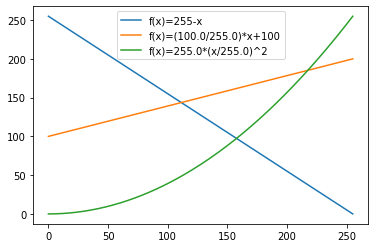

In [22]:
x = np.array(range(0,256))

plt.plot(x,255-x)
plt.plot(x,(100.0/255.0)*x + 100)
plt.plot(x,255.0*(x/255.0)**2)
plt.legend(['f(x)=255-x', 'f(x)=(100.0/255.0)*x+100', 'f(x)=255.0*(x/255.0)^2'])


可以用以下命令查看图像中的最小和最大像素值。

In [23]:
im1.min(), im1.max()

(0, 255)

PIL 中 array() 的反相操作是 fromarray()。

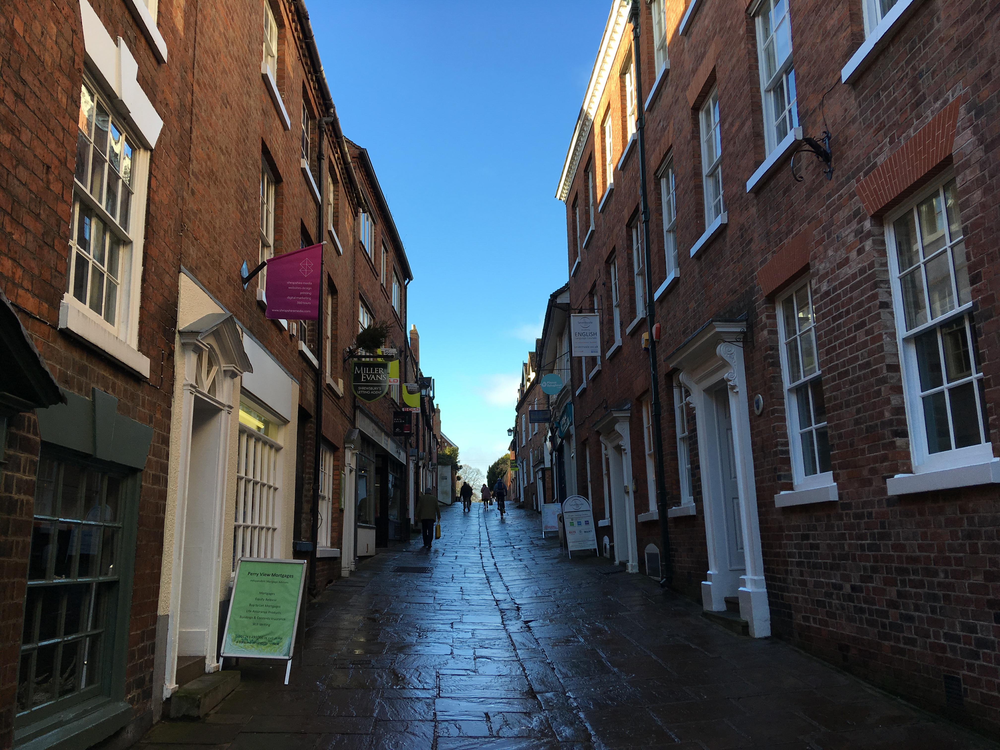

In [24]:
im = plt.array(Image.open('./img/view.jpg'))
pil_im = Image.fromarray(im)
pil_im

### 3.3 直方图均衡化

图像灰度变换中一个非常有用的例子就是直方图均衡化。直方图均衡化是指将一幅图像的灰度直方图变平，使变换后的图像中每个灰度值的分布概率都相同。在对图像做进一步处理之前，直方图均衡化通常是对图像灰度值进行归一化的一个非常好的方法，并且可以增强图像的对比度。

在这种情况下，直方图均衡化的变换函数是图像中像素值的累积分布函数(cumulative distribution function，简写为 cdf，将像素值的范围映射到目标范围的归一化操作)。

下面的函数是直方图均衡化的具体实现。

In [25]:
def histeq(im, nbr_bins=256):
    """对一幅灰度图像进行直方图均衡化"""
    
    # 计算图像的直方图
    imhist, bins = plt.histogram(im.flatten(), nbr_bins)
    cdf = imhist.cumsum()
    cdf = 255 * cdf / cdf[-1]  # 归一化
    
    # 使用累积分布函数的线性插值，计算新的像素值
    im2 = plt.interp(im.flatten(), bins[:-1],cdf)
    
    return im2.reshape(im.shape), cdf

该函数有两个输入参数，一个是灰度图像，一个是直方图中使用小区间的数目。函数返回直方图均衡化后的图像，以及用来做像素值映射的累积分布函数。注意，函数中使用到累积分布函数的最后一个元素(下标为 -1)，目的是将其归一化到 0...1 范围。你可以像下面这样使用该函数:

In [26]:
im = np.array(Image.open('./img/view.jpg').convert('L')) 
im2,cdf = histeq(im)

变换后的直方图如下：

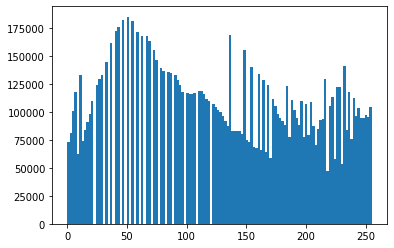

In [27]:
_ = plt.hist(im2.flatten(), bins=128)

作为对照，变换前的直方图如下：

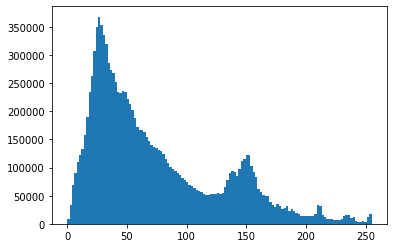

In [28]:
s = plt.hist(im.flatten(), bins=128, )[0]
plt.show('off')

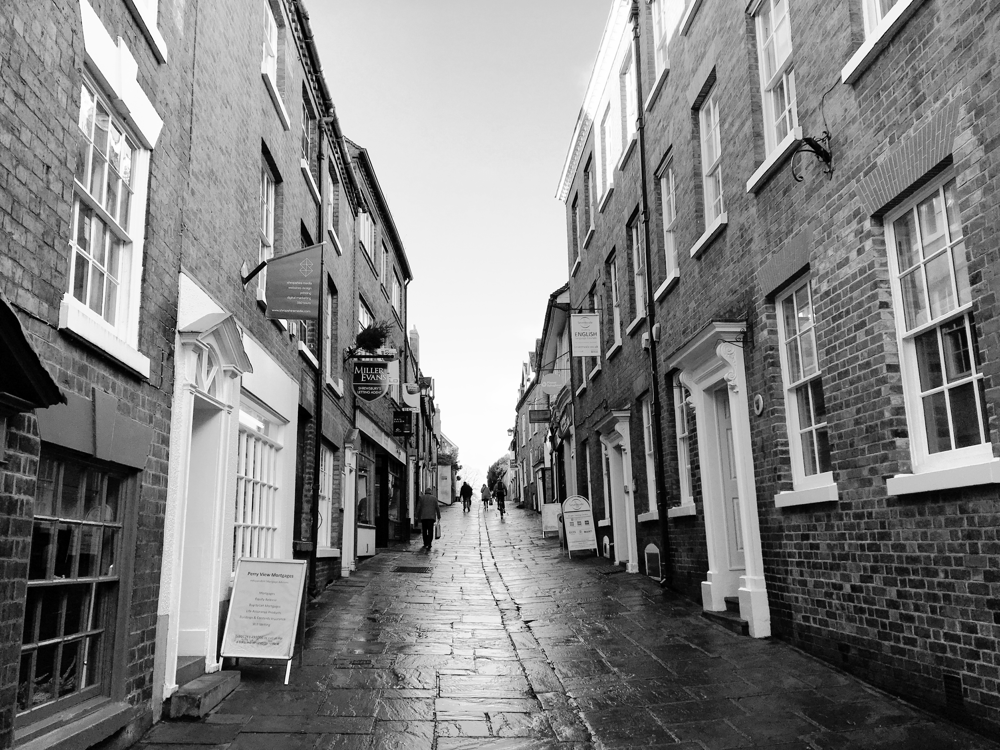

In [29]:
Image.fromarray(np.uint8(im2))

灰度变换函数图像如下：

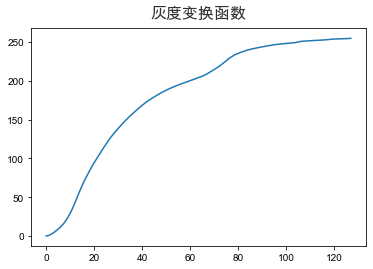

In [30]:
# 设置字体，使汉字能够正常显示
plt.rcParams['font.sans-serif'] = ['Arial Unicode MS']

# 设置字体颜色
plt.rcParams['text.color'] = '#333333'

x = np.array(range(128))
y = 255 * s.cumsum() / s.cumsum()[-1]
plt.plot(x,y)
_ = plt.title('灰度变换函数', fontsize='16', pad='10')

### 3.4 图像平均

图像平均操作是减少图像噪声的一种简单方式，通常用于艺术特效。我们可以简单地从图像列表中计算出一幅平均图像。**假设所有的图像具有相同的大小**，我们可以将这些图像简单地相加，然后除以图像的数目，来计算平均图像。

* MNIST 数据集

为了获取一系列大小相同的图像，我们引入了[MNIST 数据集](http://yann.lecun.com/exdb/mnist/)。MNIST 数据集是一个手写数字图像数据集。

如果你安装了 TensorFlow，可以用如下方式导入 MNIST 数据集。

```
from tensorflow.examples.tutorials.mnist import input_data
mnist = input_data.read_data_sets("./data/", one_hot=True)
```

如果没有，也可以按本文的方式直接加载。

In [31]:
%run load_mnist

train_images = load_train_images()
train_labels = load_train_labels()

In [32]:
def compute_average(imlist):
    """计算图像列表的平均图像"""
    
    # 打开第一幅图像，将其存储在浮点型数组中
    averageim = np.array(imlist[0], 'f')
    
    for im in imlist[1:]:
        averageim += np.array(im, 'f')
    averageim /= len(imlist)
    
    # 返回uint8类型的平均图像
    return np.array(averageim, 'uint8')

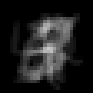

In [33]:
imlist = train_images[:10]
im_mean = compute_average(imlist)
imresize(im_mean, 0.3)

### 3.5 图像的主成分分析（PCA）

PCA(Principal Component Analysis，主成分分析)是一个非常有用的降维技巧。它 可以在使用尽可能少维数的前提下，尽量多地保持训练数据的信息，在此意义上是一个最佳技巧。即使是一幅 100×100 像素的小灰度图像，也有 10000 维，可以看成 10 000 维空间中的一个点。一兆像素的图像具有百万维。由于图像具有很高的维 数，在许多计算机视觉应用中，我们经常使用降维操作。PCA 产生的投影矩阵可以被视为将原始坐标变换到现有的坐标系，坐标系中的各个坐标按照重要性递减排列。

为了对图像数据进行 PCA 变换，图像需要转换成一维向量表示。我们可以使用 NumPy 类库中的 flatten() 方法进行变换。

将变平的图像堆积起来，我们可以得到一个矩阵，矩阵的一行表示一幅图像。在计算主方向之前，所有的行图像按照平均图像进行了中心化。我们通常使用 SVD(Singular Value Decomposition，奇异值分解)方法来计算主成分;但当矩阵的维数很大时， SVD 的计算非常慢，所以此时通常不使用 SVD 分解。下面就是 PCA 操作的代码:

In [34]:
def pca(X):
    """ 主成分分析:
    输入:矩阵 X ，其中该矩阵中存储训练数据，每一行为一条训练数据 
    返回:投影矩阵(按照维度的重要性排序)、方差和均值 """

    # 获取维数 
    num_data,dim = X.shape

    # 数据中心化
    mean_X = X.mean(axis=0)
    X = X - mean_X

    if dim > num_data:
        # PCA- 使用紧致技巧
        M = np.dot(X,X.T) # 协方差矩阵
        e,EV = np.linalg.eigh(M) # 特征值和特征向量
        tmp = np.dot(X.T,EV).T # 这就是紧致技巧
        V = tmp[::-1] # 由于最后的特征向量是我们所需要的，所以需要将其逆转
        S = np.sqrt(e)[::-1] # 由于特征值是按照递增顺序排列的，所以需要将其逆转
        for i in range(V.shape[1]):
            V[:,i] /= S 
    else:
        # PCA-使用SVD方法
        U,S,V = np.linalg.svd(X)
        V = V[:num_data] # 仅仅返回前 num_data 维的数据才合理
    # 返回投影矩阵、方差和均值 
    return V,S,mean_X

/Users/changluo/opt/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:19: RuntimeWarning: invalid value encountered in sqrt


[[ 0.  0.  0. ...  0.  0.  0.]
 [ 0.  0.  0. ...  0.  0.  0.]
 [ 0.  0.  0. ...  0.  0.  0.]
 ...
 [ 0.  0.  0. ...  0.  0.  0.]
 [ 0.  0.  0. ...  0.  0.  0.]
 [nan nan nan ... nan nan nan]] 10


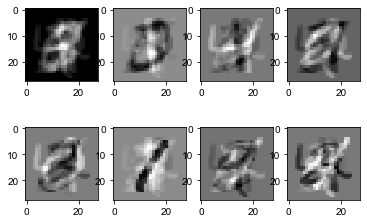

In [35]:
imlist = train_images[:10]
im = np.array(imlist[0]) # 打开一幅图像，获取其大小 
m,n = im.shape[0:2] # 获取图像的大小
imnbr = len(imlist) # 获取图像的数目

# 创建矩阵，保存所有压平后的图像数据
immatrix = np.array([np.array(Image.fromarray(im).convert('L')).flatten() for im in imlist],'f') 

# 执行PCA操作
V,S,immean = pca(immatrix)
print(V, len(V))

# 显示一些图像(均值图像和前 7 个模式) 
plt.figure()
plt.gray()
plt.subplot(2,4,1) 
plt.imshow(immean.reshape(m,n))
for i in range(7): 
    plt.subplot(2,4,i+2) 
    plt.imshow(V[i].reshape(m,n))
    
plt.show()

### 3.6 使用pickle模块

如果想要保存一些结果或者数据以方便后续使用，Python 中的 pickle 模块非常有用。pickle 模块可以接受几乎所有的 Python 对象，并且将其转换成字符串表示，该过程叫做封装(pickling)。从字符串表示中重构该对象，称为拆封(unpickling)。这些字符串表示可以方便地存储和传输。

我们来看一个例子。假设想要保存上一节字体图像的平均图像和主成分，可以这样来完成:

In [36]:
import pickle

# 打开文件并保存
with open('./data/font_pca_modes.pkl', 'wb') as f:
    # 保存均值和主成分数据
    pickle.dump(immean,f) 
    pickle.dump(V,f)

在上述例子中，许多对象可以保存到同一个文件中。pickle 模块中有很多不同的协议可以生成 .pkl 文件;如果不确定的话，最好以二进制文件的形式读取和写入。在其他 Python 会话中载入数据，只需要如下使用 load() 方法:

In [37]:
# 打开文件并保存
with open('./data/font_pca_modes.pkl', 'rb') as f:
    # 载入均值和主成分数据
    immean = pickle.load(f)
    V = pickle.load(f)

In [38]:
# immean, V

注意，载入对象的顺序必须和先前保存的一样。Python 中有个用C语言写的优化版本，叫做 cpickle 模块，该模块和标准 pickle 模块完全兼容。关于 pickle 模块的更多内容，参见 pickle 模块文档页 [http://docs.python.org/library/pickle.html](http://docs.python.org/library/pickle.html)。

## 4. SciPy

SciPy([http://scipy.org/](http://scipy.org/))是建立在 NumPy 基础上，用于数值运算的开源工具包。 SciPy 提供很多高效的操作，可以实现数值积分、优化、统计、信号处理，以及对我们来说最重要的图像处理功能。

### 4.1 图像模糊

图像的高斯模糊是非常经典的图像卷积例子。本质上，图像模糊就是将(灰度)图像 $I$ 和一个高斯核进行卷积操作:

$$ I_{\sigma} = I * G_{\sigma} $$ 

其中 $ * $ 表示卷积操作；$ G_{\sigma} $ 是标准差为 $ \sigma $ 的二维高斯核，定义为：

$$ G_{\sigma} = \frac{1}{2\pi\sigma} e^{-(x^{2}+y^{2}) / 2\sigma^{2}} $$

高斯模糊通常是其他图像处理操作的一部分，比如图像插值操作、兴趣点计算以及很多其他应用。

SciPy 有用来做滤波操作的 scipy.ndimage.filters 模块。该模块使用快速一维分离 的方式来计算卷积。你可以像下面这样来使用它:

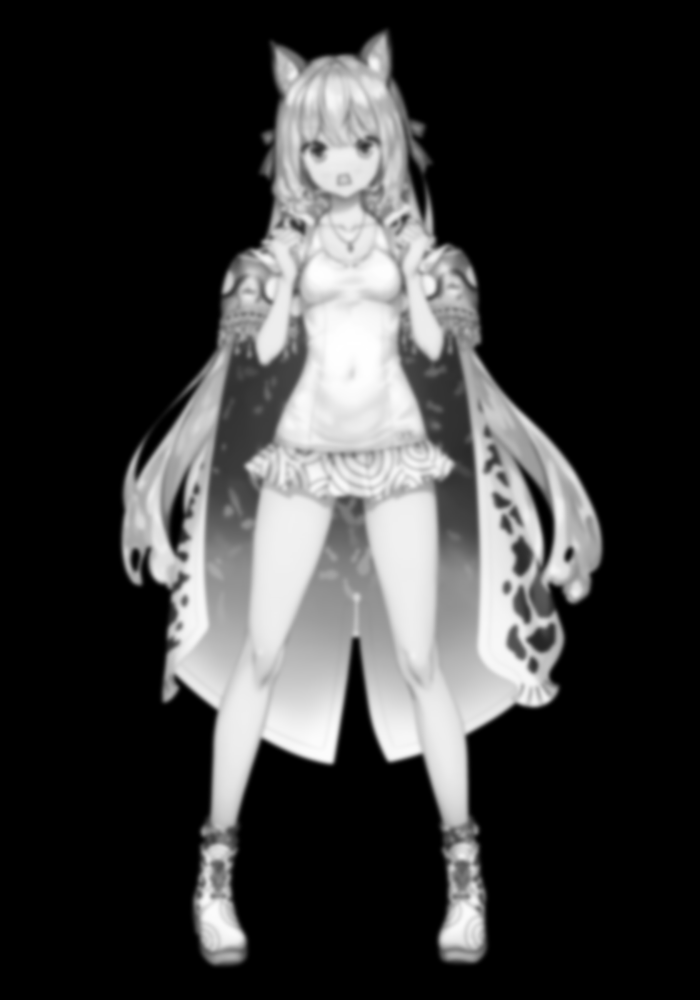

In [39]:
from scipy.ndimage import filters

im = np.array(Image.open('./img/nyatsuki.png').convert('L')) 
im2 = filters.gaussian_filter(im,10)
Image.fromarray(im2)

上面 guassian_filter() 函数的最后一个参数表示标准差。

随着 $\sigma$ 的增加，一幅图像被模糊的程度。$\sigma$ 越大，处理后的图像细节丢失越多。如果打算模糊一幅彩色图像，只需简单地对每一个颜色通道进行高斯模糊:

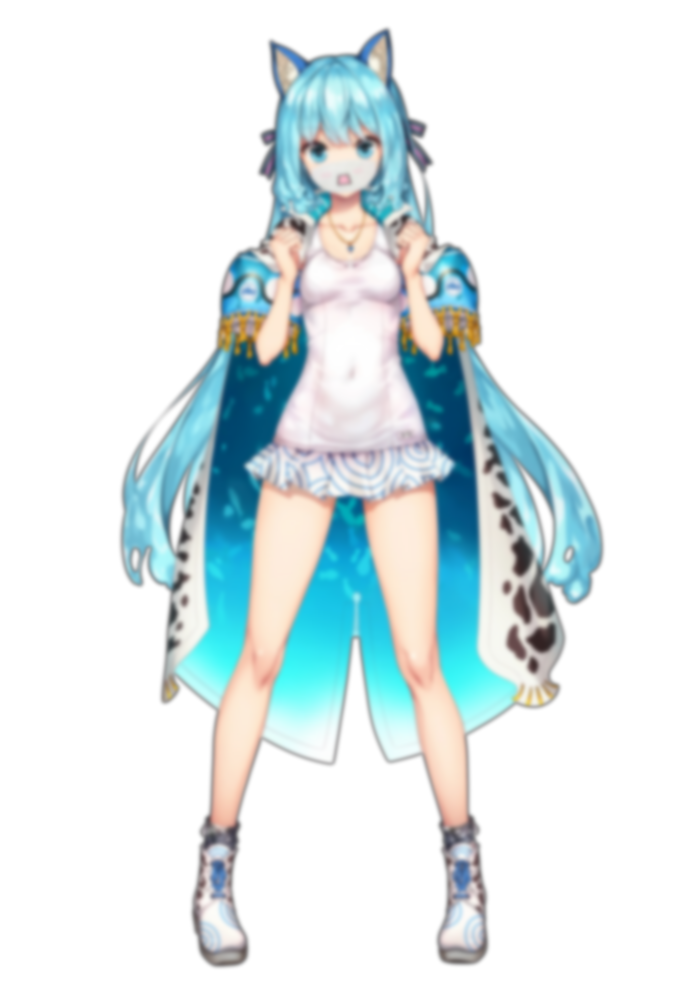

In [40]:
im = np.array(Image.open('./img/nyatsuki.png'))
im2 = np.zeros(im.shape)
for i in range(4):
    im2[:,:,i] = filters.gaussian_filter(im[:,:,i],10)
im2 = np.uint8(im2)
Image.fromarray(im2)

### 4.2 图像导数

整本书中可以看到，在很多应用中图像强度的变化情况是非常重要的信息。强度的变化可以用灰度图像 $I$ (对于彩色图像，通常对每个颜色通道分别计算导数)的 $x$ 和 $y$ 方向导数 $I_{x}$ 和 $I_{y}$ 进行描述。

图像的梯度向量为 $\Delta I = [I_{x}, I_{y}]^{T}$ 。梯度有两个重要的属性，一是梯度的大小:

$$ | \nabla \boldsymbol{I} |=\sqrt{{\boldsymbol{I}_{x}}^{2}+{\boldsymbol{I}_{y}}^{2}} $$

它描述了图像强度变化的强弱，一是梯度的角度:

$$ \alpha=\arctan 2\left(\boldsymbol{I}_{y}, \boldsymbol{I}_{x}\right) $$

描述了图像中在每个点(像素)上强度变化最大的方向。NumPy 中的 arctan2() 函数返回弧度表示的有符号角度，角度的变化区间为 $-π...π$。

我们可以用离散近似的方式来计算图像的导数。图像导数大多数可以通过卷积简单地实现:

$$ \boldsymbol{I}_{x}=\boldsymbol{I}^{*} D_{x} 和 \boldsymbol{I}_{y}=\boldsymbol{I}^{*} D_{y} $$

对于 $D_{x}$ 和 $D_{y}$，通常选择 Prewitt 滤波器:

$$ D_{x}=\left[\begin{array}{ccc}
{-1} & {0} & {1} \\
{-1} & {0} & {1} \\
{-1} & {0} & {1}
\end{array}\right] 和 D_{y}=\left[\begin{array}{ccc}
{-1} & {-1} & {-1} \\
{0} & {0} & {0} \\
{1} & {1} & {1}
\end{array}\right] $$

或者 Sobel 滤波器:

$$ D_{x}=\left[\begin{array}{ccc}
{-1} & {0} & {1} \\
{-2} & {0} & {2} \\
{-1} & {0} & {1}
\end{array}\right] 和 D_{y}=\left[\begin{array}{ccc}
{-1} & {-2} & {-1} \\
{0} & {0} & {0} \\
{1} & {2} & {1}
\end{array}\right] $$

这些导数滤波器可以使用 scipy.ndimage.filters 模块的标准卷积操作来简单地实现。

#### 4.2.1 Sobel 滤波器

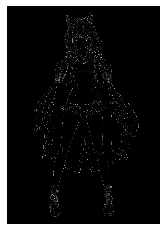

In [41]:
im = np.array(Image.open('./img/nyatsuki.png').convert('L'))

# Sobel 导数滤波器
imx = np.zeros(im.shape) 
filters.sobel(im,1,imx)

imy = np.zeros(im.shape) 
filters.sobel(im,0,imy)

magnitude = np.sqrt(imx**2+imy**2)
plt.imshow(magnitude)
_ = plt.axis('off')

上面的脚本使用 Sobel 滤波器来计算 x 和 y 的方向导数，以及梯度大小。sobel() 函数的第二个参数表示选择 x 或者 y 方向导数，第三个参数保存输出的变量。

在导数图像中，正导数显示为亮的 像素，负导数显示为暗的像素。灰色区域表示导数的值接近于零。

#### 4.2.2 高斯导数滤波器

上述计算图像导数的方法有一些缺陷:在该方法中，滤波器的尺度需要随着图像分辨率的变化而变化。为了在图像噪声方面更稳健，以及在任意尺度上计算导数，我 们可以使用高斯导数滤波器:

$$ \boldsymbol{I}_{x}=\boldsymbol{I} * G_{\sigma x} 和 \boldsymbol{I}_{y}=\boldsymbol{I} * G_{\sigma y} $$

其中，$G_{\sigma x}$ 和 $G_{\sigma y}$ 表示 $G_{\sigma}$ 在 $x$ 和 $y$ 方向上的导数，$G_{\sigma}$ 为标准差为 $\sigma$ 的高斯函数。

我们之前用于模糊的 filters.gaussian_filter() 函数可以接受额外的参数，用来计算高斯导数。可以简单地按照下面的方式来处理:

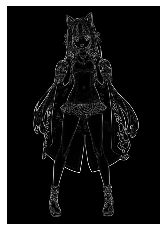

In [42]:
sigma = 5 # 标准差

imx = np.zeros(im.shape)
filters.gaussian_filter(im, (sigma,sigma), (0,1), imx)

imy = np.zeros(im.shape)
filters.gaussian_filter(im, (sigma,sigma), (1,0), imy)

magnitude = np.sqrt(imx**2+imy**2)
plt.imshow(magnitude)
_ = plt.axis('off')

该函数的第三个参数指定对每个方向计算哪种类型的导数，第二个参数为使用的标准差。

### 4.3 形态学:对象计数

形态学(或数学形态学)是度量和分析基本形状的图像处理方法的基本框架与集合。形态学通常用于处理二值图像，但是也能够用于灰度图像。二值图像是指图像的每个像素只能取两个值，通常是 0 和 1。二值图像通常是，在计算物体的数目，或者度量其大小时，对一幅图像进行阈值化后的结果。你可以从  http://en.wikipedia.org/wiki/Mathematical_morphology 大体了解形态学及其处理图像的方式。

scipy.ndimage 中的 morphology 模块可以实现形态学操作。你可以使用 scipy. ndimage 中的 measurements 模块来实现二值图像的计数和度量功能。下面通过一个简单的例子介绍如何使用它们。

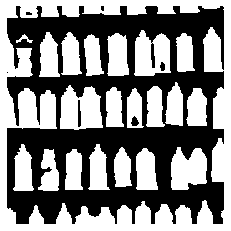

In [43]:
from scipy.ndimage import measurements,morphology

# 载入图像，然后使用阈值化操作，以保证处理的图像为二值图像 
im = np.array(Image.open('./img/object.png').convert('L'))
im = 1*(im<128)

plt.imshow(im)
_ = plt.axis('off')

In [44]:
labels, nbr_objects = measurements.label(im)
print("Number of objects:", nbr_objects)

Number of objects: 46


上面的脚本首先载入该图像，通过阈值化方式来确保该图像是二值图像。通过和 1 相乘，脚本将布尔数组转换成二进制表示。然后，我们使用 label() 函数寻找单个的物体，并且按照它们属于哪个对象将整数标签给像素赋值。图 1-12b 是 labels 数 组的图像。图像的灰度值表示对象的标签。可以看到，在一些对象之间有一些小的连接。进行二进制开(binary open)操作，我们可以将其移除:

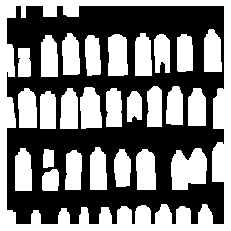

In [45]:
# 形态学开操作更好地分离各个对象
im_open = morphology.binary_opening(im,np.ones((9,5)),iterations=2)

plt.imshow(im_open)
_ = plt.axis('off')

In [46]:
labels_open, nbr_objects_open = measurements.label(im_open) 
print("Number of objects:", nbr_objects_open)

Number of objects: 44


binary_opening() 函数的第二个参数指定一个数组结构元素。该数组表示以一个 像素为中心时，使用哪些相邻像素。在这种情况下，我们在 y 方向上使用 9 个像 素(上面 4 个像素、像素本身、下面 4 个像素)，在 x 方向上使用 5 个像素。你 可以指定任意数组为结构元素，数组中的非零元素决定使用哪些相邻像素。参数 iterations 决定执行该操作的次数。你可以尝试使用不同的迭代次数 iterations 值， 看一下对象的数目如何变化。

### 4.4 图像去噪

图像去噪是在去除图像噪声的同时，尽可能地保留图像细节和结构的处理技术。我们这里使用 ROF (Rudin-Osher-Fatemi)去噪模型。图像去噪对于很多应用来说都非常重要;这些应用范围很广，小到让你的假期照片看起来更漂亮，大到提高卫星图像的质量。ROF 模型具有很好的性质:使处理后的图像更平滑，同时保持图像边缘和结构信息。

ROF 模型的数学基础和处理技巧非常高深，不在本书讲述范围之内。在讲述如何基于 Chambolle 提出的算法实现 ROF 求解器之前，本书首先简要介绍一下 ROF 模型。

一幅(灰度)图像 I 的全变差(Total Variation，TV)定义为梯度范数之和。在连续表示的情况下，全变差表示为:

$$ J(\boldsymbol{I})=\int|\nabla \boldsymbol{I}| \mathrm{d} \mathbf{x} $$

在离散表示的情况下，全变差表示为:

$$ J(\boldsymbol{I})=\sum_{\mathbf{x}}|\nabla \boldsymbol{I}| $$

其中，上面的式子是在所有图像坐标 $ x=[x, y] $ 上取和。

在 Chambolle 提出的 ROF 模型里，目标函数为寻找降噪后的图像 U，使下式最小:

$$ \min _{U}\|\boldsymbol{I}-\boldsymbol{U}\|^{2}+2 \lambda J(\boldsymbol{U}) $$

其中范数 $ \|\boldsymbol{I}-\boldsymbol{U}\| $ 是去噪后图像 $U$ 和原始图像 $I$ 差异的度量。也就是说，本质上该模型使去噪后的图像像素值“平坦”变化，但是在图像区域的边缘上，允许去噪后的图像像素值“跳跃”变化。

我们可以按照下面的代码实现 ROF 模型去噪:

In [47]:
def denoise(im,U_init,tolerance=0.1,tau=0.125,tv_weight=100):
    """ 使用 A. Chambolle(2005)在公式(11)中的计算步骤实现 Rudin-Osher-Fatemi(ROF)去噪模型
    输入:含有噪声的输入图像(灰度图像)、U 的初始值、TV 正则项权值、步长、停业条件
    输出:去噪和去除纹理后的图像、纹理残留 """ 
    m,n = im.shape  # 噪声图像的大小
    
    # 初始化
    U = U_init
    Px = im # 对偶域的x分量 
    Py = im # 对偶域的y分量 
    error = 1
    
    while (error > tolerance): 
        Uold = U
        
        # 原始变量的梯度
        GradUx = np.roll(U,-1,axis=1)-U # 变量 U 梯度的 x 分量 
        GradUy = np.roll(U,-1,axis=0)-U # 变量 U 梯度的 y 分量

        # 更新对偶变量
        PxNew = Px + (tau/tv_weight)*GradUx
        PyNew = Py + (tau/tv_weight)*GradUy
        NormNew = np.maximum(1,np.sqrt(PxNew**2+PyNew**2))

        Px = PxNew/NormNew # 更新 x 分量(对偶) 
        Py = PyNew/NormNew # 更新 y 分量(对偶)

        # 更新原始变量
        RxPx = np.roll(Px,1,axis=1) # 对 x 分量进行向右 x 轴平移 
        RyPy = np.roll(Py,1,axis=0) # 对 y 分量进行向右 y 轴平移

        DivP = (Px-RxPx)+(Py-RyPy) # 对偶域的散度 
        U = im + tv_weight*DivP # 更新原始变量

        # 更新误差
        error = np.linalg.norm(U-Uold)/np.sqrt(n*m);
    
    return U,im-U # 去噪后的图像和纹理残余    

在这个例子中，我们使用了 roll() 函数。顾名思义，在一个坐标轴上，它循环“滚动”数组中的元素值。该函数可以非常方便地计算邻域元素的差异，比如这里的 导数。我们还使用了 linalg.norm() 函数，该函数可以衡量两个数组间(这个例子中是指图像矩阵 U 和 Uold)的差异。

下面使用一个合成的噪声图像示例来说明如何使用该函数：

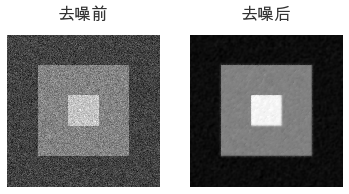

In [48]:
# 使用噪声创建合成图像
im = np.zeros((500,500))
im[100:400,100:400] = 128
im[200:300,200:300] = 255
im = im + 30*np.random.standard_normal((500,500))

U,T = denoise(im,im)
G = filters.gaussian_filter(im,10)

plt.subplot(121)
plt.imshow(im)
plt.title('去噪前', fontsize='17', pad='15')
_ = plt.axis('off')

plt.subplot(122)
plt.imshow(U)
plt.title('去噪后', fontsize='17', pad='15')
_ = plt.axis('off')

# plt.imshow(T)
# _ = plt.axis('off')

下面看一下在实际图像中使用 ROF 模型去噪的效果：

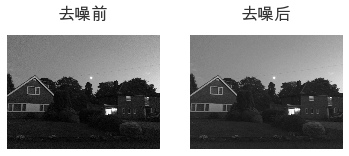

In [49]:
pil_noise = Image.open('./img/noise.jpg')
im_noise = np.array(pil_noise.convert('L'))

im = np.array(pil_noise.convert('L')) 
U,T = denoise(im,im)

plt.subplot(121)
plt.imshow(im_noise)
plt.title('去噪前', fontsize='17', pad='15')
_ = plt.axis('off')

plt.subplot(122)
plt.imshow(U)
plt.title('去噪后', fontsize='17', pad='15')
_ = plt.axis('off') 

## 5. GIF图像处理

### 5.1 将 GIF 图像拆分为图片

In [50]:
import os
from PIL import Image, ImageSequence


def parseGIF(gifname):
    """将gif解析为图片"""
    
    # 读取GIF
    im = Image.open(gifname)
    
    # GIF图片流的迭代器
    items = ImageSequence.Iterator(im)
    
    # 获取文件名
    file_name = gifname.split(".")[0]
    index = 0

    # 判断目录是否存在
    pic_dirct = "./img/gif/{0}".format(file_name)
    mkdirlambda = lambda x: os.makedirs(x) if not os.path.exists(x) else True  # 目录是否存在,不存在则创建
    mkdirlambda(pic_dirct)

    # 遍历图片流的每一帧
    for frame in items:
        # print("image %d: mode %s, size %s" % (index, frame.mode, frame.size))
        frame.save("./img/gif/%s/frame%d.png" % (file_name, index+1))
        index += 1
        
    return (items, index)


def reverseGIF(gifname):
    """制作逆序gif图像"""
    
    # 读取GIF
    im = Image.open(gifname)
    
    # 把GIF拆分为图片流
    imgs = [frame.copy() for frame in ImageSequence.Iterator(im)]

    # 图片流反序
    imgs.reverse()
    
    # 将反序后的所有帧图像保存下来
    pic_dirct = './img/reverse.gif'
    imgs[0].save(pic_dirct, save_all=True, append_images=imgs[1:])
    
    return pic_dirct

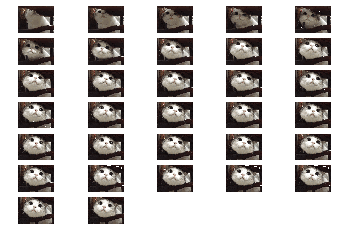

In [51]:
im_list, cnt = parseGIF('./img/cute.gif')
columns = 5

for i in range(cnt):
    plt.subplot(int(cnt/columns)+1, columns, i+1)
    plt.imshow(im_list[i])
    plt.axis('equal')
    plt.axis('off')

### 5.2 制作逆序gif图像

In [52]:
pic_dirct = reverseGIF('./img/cute.gif')
print('请打开目录查看图片：{}。'.format(pic_dirct))

请打开目录查看图片：./img/reverse.gif。


参考书籍：《Python计算机视觉编程》